# Time series I

In [47]:
import datetime
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns



from sklearn.metrics import mean_absolute_percentage_error
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR,LinearSVR


import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa.deterministic import DeterministicProcess
from statsmodels.tsa.seasonal import seasonal_decompose


import warnings
warnings.filterwarnings("ignore")

There are two kinds of features unique to time series: 
* time-step features and 
* lag features.

# Data

## Australian consumption

            electricity
datetime               
1956-03-01         3923
1956-06-01         4436
1956-09-01         4806
1956-12-01         4418
1957-03-01         4339


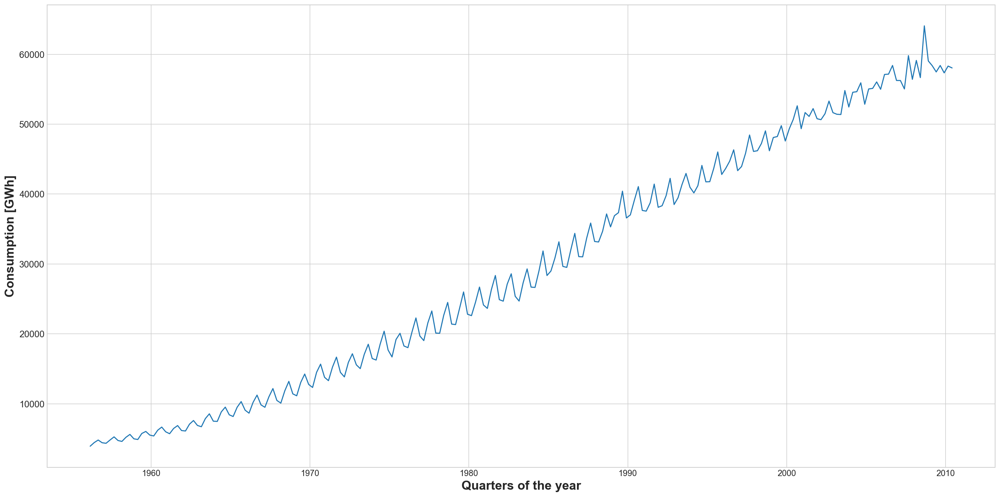

In [93]:
df = pd.read_excel('data/Australia_electricty_data.xlsx')
df = df.rename(columns={"Unnamed: 0":"datetime", "Electricity [GWh]": "electricity"})
df.set_index('datetime',inplace=True)

print(df.head(5))

plt.style.use("seaborn-whitegrid")
plt.figure(figsize=(20,10))
p=sns.lineplot(data= df);
p.set_ylabel("Consumption [GWh]", fontsize = 18);
p.set_xlabel("Quarters of the year", fontsize = 18);
plt.xticks(fontsize=12)
plt.yticks(fontsize=13)
plt.legend('', frameon=False);

In [94]:
# Crop
au_elec_series_short = df.loc['1956-03-01':'1985-12-01']

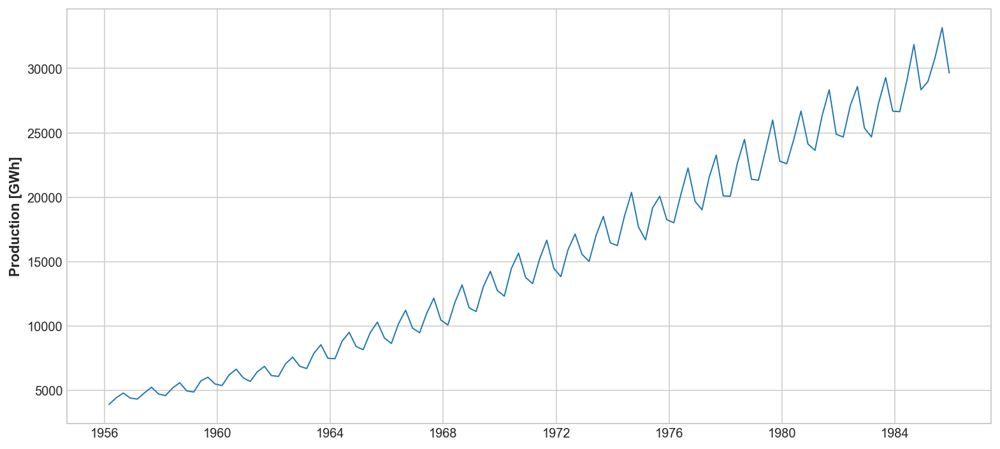

In [95]:
plt.figure(figsize=(11, 5))
plt.plot(au_elec_series_short['electricity'], lw=1)
plt.ylabel('Production [GWh]', fontsize=11)
plt.show()

## Estonian consumption

In [96]:
el2022 = pd.read_csv('data/electricity-production and consumption_2022.csv',  delimiter=';',decimal=',')
el2022['timestamp'] = pd.to_datetime(el2022['Kuupaev (Eesti aeg)'], dayfirst=True)

consumption = el2022[['timestamp', 'Tarbimine']]
consumption.set_index('timestamp', inplace=True)
consumption = consumption.rename(columns = {'Tarbimine':'value'})
consumption.head()

,value
timestamp,
2022-01-01 00:00:00,899.4
2022-01-01 01:00:00,892.1
2022-01-01 02:00:00,874.3
2022-01-01 03:00:00,860.1
2022-01-01 04:00:00,842.7


# Lags and shifts

In [97]:
consumption_lag1h = consumption[['value']].shift(1)
consumption_lag1h = consumption_lag1h.rename(columns = {'value':'lag1h'})
consumption = consumption.join(consumption_lag1h)

In [98]:
consumption

,value,lag1h
timestamp,,
2022-01-01 00:00:00,899.4,NaN
2022-01-01 01:00:00,892.1,899.4
2022-01-01 02:00:00,874.3,892.1
2022-01-01 03:00:00,860.1,874.3
2022-01-01 04:00:00,842.7,860.1
...,...,...
2022-12-31 19:00:00,989.4,1042.8
2022-12-31 20:00:00,932.5,989.4
2022-12-31 21:00:00,889.5,932.5


In [99]:
consumption_lag2h = consumption[['value']].shift(2)
consumption_lag2h = consumption_lag2h.rename(columns = {'value':'lag2h'})
consumption = consumption.join(consumption_lag2h)

In [100]:
consumption

,value,lag1h,lag2h
timestamp,,,
2022-01-01 00:00:00,899.4,NaN,NaN
2022-01-01 01:00:00,892.1,899.4,NaN
2022-01-01 02:00:00,874.3,892.1,899.4
2022-01-01 03:00:00,860.1,874.3,892.1
2022-01-01 04:00:00,842.7,860.1,874.3
...,...,...,...
2022-12-31 19:00:00,989.4,1042.8,1085.3
2022-12-31 20:00:00,932.5,989.4,1042.8
2022-12-31 21:00:00,889.5,932.5,989.4


## Moving average

In [102]:
au_elec_series_short.head(10)

,electricity
datetime,
1956-03-01,3923
1956-06-01,4436
1956-09-01,4806
1956-12-01,4418
1957-03-01,4339
1957-06-01,4811
1957-09-01,5259
1957-12-01,4735
1958-03-01,4608


In [105]:
ma3 = au_elec_series_short['electricity'].rolling(3).mean().round(2).to_frame().shift(-1)
ma3 = ma3.rename(columns = {'electricity':'3-ma'})
ma3.set_index(au_elec_series_short.index,inplace=True)
ma_ex = au_elec_series_short.join(ma3)
ma_ex.head(10)

,electricity,3-ma
datetime,,
1956-03-01,3923,NaN
1956-06-01,4436,4388.33
1956-09-01,4806,4553.33
1956-12-01,4418,4521.00
1957-03-01,4339,4522.67
1957-06-01,4811,4803.00
1957-09-01,5259,4935.00
1957-12-01,4735,4867.33
1958-03-01,4608,4846.33


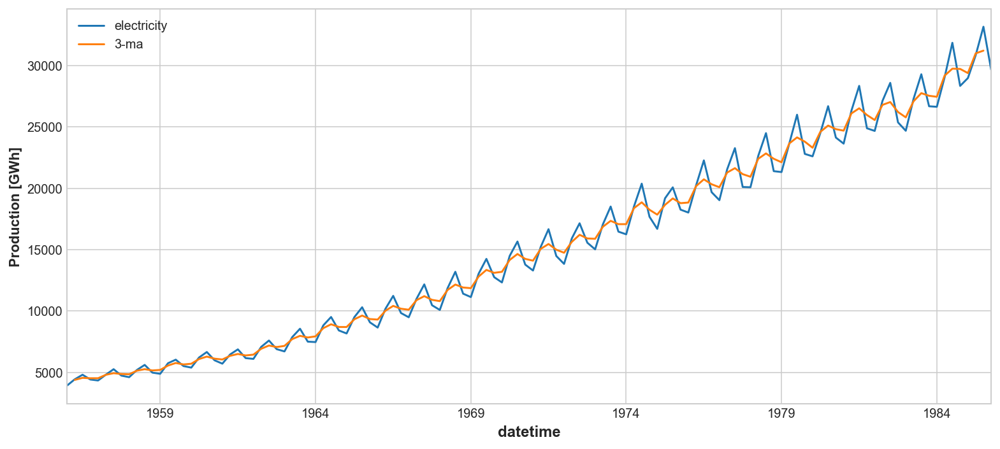

In [103]:
ma_ex[['electricity', '3-ma']].plot(label='production', 
                                  figsize=(11, 5))
plt.ylabel('Production [GWh]', fontsize=11);

In [106]:
ma5 = au_elec_series_short['electricity'].rolling(5).mean().round(2).to_frame()
ma5 = ma5.rename(columns = {'electricity':'5-ma'})
ma5.set_index(au_elec_series_short.index,inplace=True)
ma_ex = ma_ex.join(ma5)
ma_ex.head(10)

,electricity,3-ma,5-ma
datetime,,,
1956-03-01,3923,NaN,NaN
1956-06-01,4436,4388.33,NaN
1956-09-01,4806,4553.33,NaN
1956-12-01,4418,4521.00,NaN
1957-03-01,4339,4522.67,4384.4
1957-06-01,4811,4803.00,4562.0
1957-09-01,5259,4935.00,4726.6
1957-12-01,4735,4867.33,4712.4
1958-03-01,4608,4846.33,4750.4


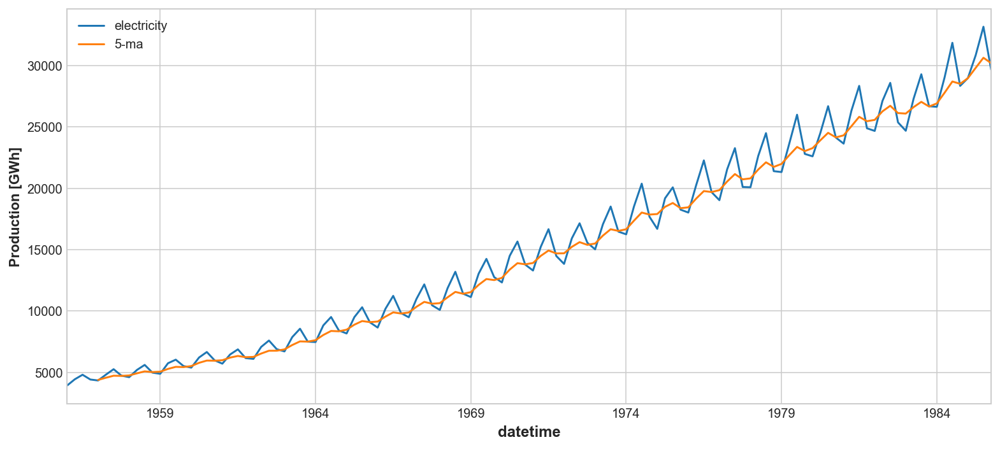

In [107]:
ma_ex[['electricity', '5-ma']].plot(label='production', 
                                  figsize=(11, 5))
plt.ylabel('Production [GWh]', fontsize=11);

In [108]:
ma4 = au_elec_series_short['electricity'].rolling(4).mean().round(2).to_frame()
ma4 = ma4.rename(columns = {'electricity':'4-ma'})
ma4.set_index(au_elec_series_short.index,inplace=True)
ma_ex = ma_ex.join(ma4)
ma_ex.head(10)

,electricity,3-ma,5-ma,4-ma
datetime,,,,
1956-03-01,3923,NaN,NaN,NaN
1956-06-01,4436,4388.33,NaN,NaN
1956-09-01,4806,4553.33,NaN,NaN
1956-12-01,4418,4521.00,NaN,4395.75
1957-03-01,4339,4522.67,4384.4,4499.75
1957-06-01,4811,4803.00,4562.0,4593.50
1957-09-01,5259,4935.00,4726.6,4706.75
1957-12-01,4735,4867.33,4712.4,4786.00
1958-03-01,4608,4846.33,4750.4,4853.25


In [109]:
ma24 = ma_ex['4-ma'].rolling(2).mean().round(2).to_frame()
ma24 = ma24.rename(columns = {'4-ma':'2x4-ma'})
ma24.set_index(au_elec_series_short.index,inplace=True)
ma_ex = ma_ex.join(ma24)
ma_ex.head(10)

,electricity,3-ma,5-ma,4-ma,2x4-ma
datetime,,,,,
1956-03-01,3923,NaN,NaN,NaN,NaN
1956-06-01,4436,4388.33,NaN,NaN,NaN
1956-09-01,4806,4553.33,NaN,NaN,NaN
1956-12-01,4418,4521.00,NaN,4395.75,NaN
1957-03-01,4339,4522.67,4384.4,4499.75,4447.75
1957-06-01,4811,4803.00,4562.0,4593.50,4546.62
1957-09-01,5259,4935.00,4726.6,4706.75,4650.12
1957-12-01,4735,4867.33,4712.4,4786.00,4746.38
1958-03-01,4608,4846.33,4750.4,4853.25,4819.62


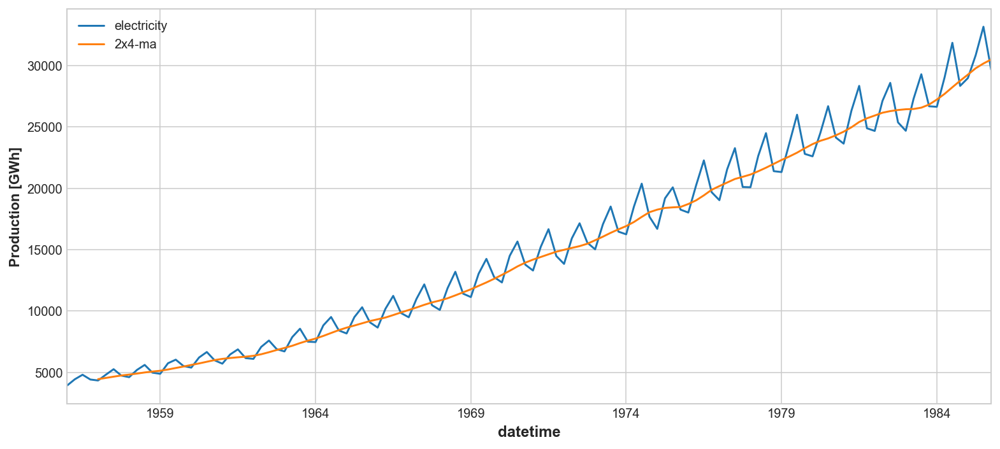

In [110]:
ma_ex[['electricity', '2x4-ma']].plot(label='production', 
                                  figsize=(11, 5))
plt.ylabel('Production [GWh]', fontsize=11);

# Time-step feature. Trend

## Time-step

In [111]:
df['time'] = np.arange(len(df.index))
df.head()

,electricity,time
datetime,,
1956-03-01,3923,0
1956-06-01,4436,1
1956-09-01,4806,2
1956-12-01,4418,3
1957-03-01,4339,4


### Linear regression with timestep

target = weight * time + bias

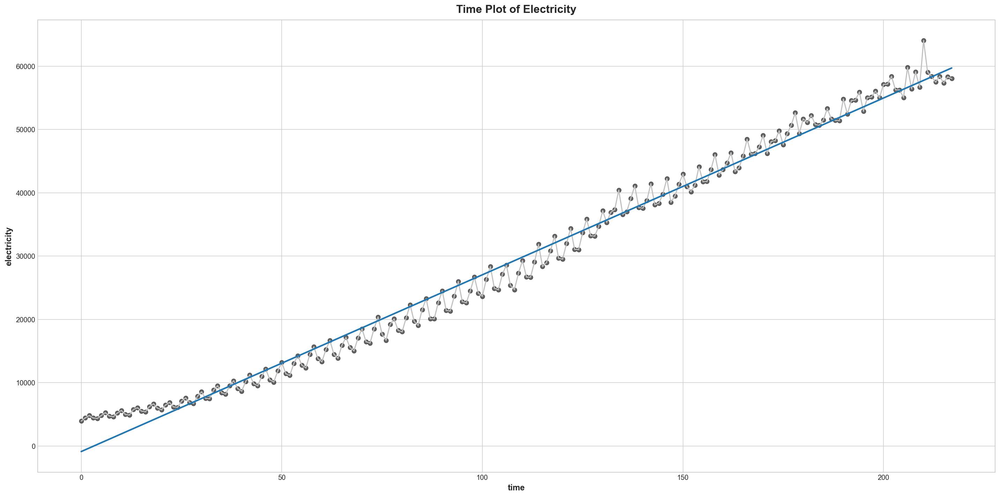

In [112]:
plt.style.use("seaborn-whitegrid")
plt.rc(
    "figure",
    autolayout=True,
    figsize=(20, 10),
    titlesize=18,
    titleweight='bold',
)
plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=16,
    titlepad=10,
)
%config InlineBackend.figure_format = 'retina'

fig, ax = plt.subplots()
ax.plot('time', 'electricity', data=df, color='0.75')
ax = sns.regplot(x='time', y='electricity', data=df, ci=None, scatter_kws=dict(color='0.25'))
ax.set_title('Time Plot of Electricity');

In [113]:
# Training data
X = df.loc[:, ['time']]  # features
y = df.loc[:, 'electricity']  # target

# Train the model
model = LinearRegression()
model.fit(X, y)

# Store the fitted values as a time series with the same time index as
# the training data
y_pred = pd.Series(model.predict(X), index=X.index)

print('Slope :', model.coef_)
print('\nIntercept Value:', model.intercept_)

Slope : [279.20064645]

Intercept Value: -883.4490385823592


## Trend

### Linear trend

In [114]:
dp = DeterministicProcess(
    index=df.index,  # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order=1,             # the time dummy (trend)
    drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X.head()

,const,trend
datetime,,
1956-03-01,1.0,1.0
1956-06-01,1.0,2.0
1956-09-01,1.0,3.0
1956-12-01,1.0,4.0
1957-03-01,1.0,5.0


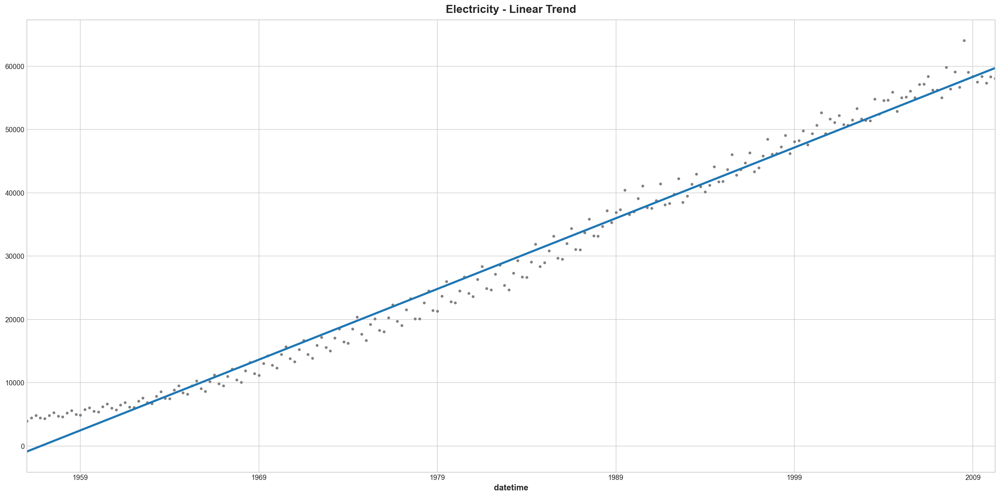

In [115]:
y = df["electricity"]  # the target

# The intercept is the same as the `const` feature from
# DeterministicProcess. LinearRegression behaves badly with duplicated
# features, so we need to be sure to exclude it here.
model = LinearRegression(fit_intercept=False)
model.fit(X, y)

y_pred = pd.Series(model.predict(X), index=X.index)

ax = df['electricity'].plot(style=".", color="0.5", title="Electricity - Linear Trend")
_ = y_pred.plot(ax=ax, linewidth=3, label="Trend")

### Non-linear trend

In [116]:
dp = DeterministicProcess(
    index=df.index,  # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order=3,             # the time dummy (trend)
    drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X.head()

,const,trend,trend_squared,trend_cubed
datetime,,,,
1956-03-01,1.0,1.0,1.0,1.0
1956-06-01,1.0,2.0,4.0,8.0
1956-09-01,1.0,3.0,9.0,27.0
1956-12-01,1.0,4.0,16.0,64.0
1957-03-01,1.0,5.0,25.0,125.0


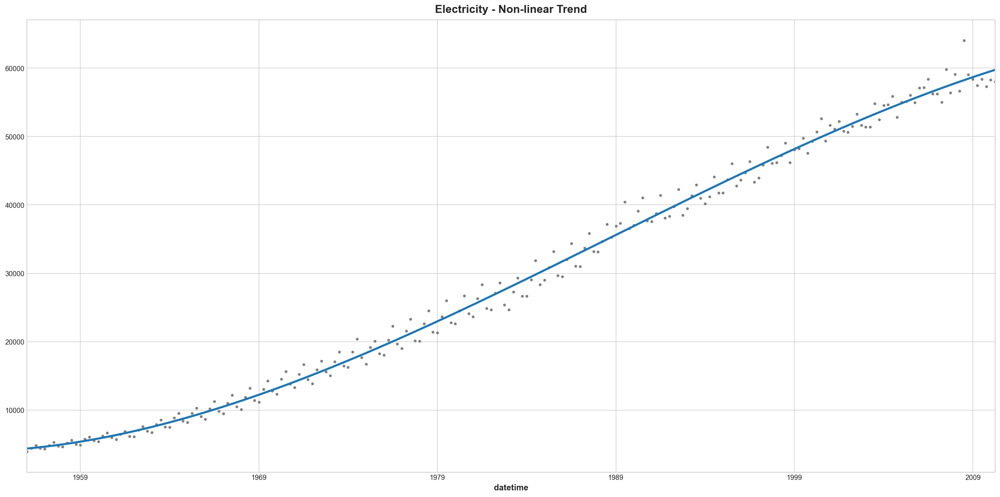

In [117]:
y = df["electricity"]  # the target

# The intercept is the same as the `const` feature from
# DeterministicProcess. LinearRegression behaves badly with duplicated
# features, so we need to be sure to exclude it here.
model = LinearRegression(fit_intercept=False)
model.fit(X, y)

y_pred = pd.Series(model.predict(X), index=X.index)

ax = df['electricity'].plot(style=".", color="0.5", title="Electricity - Non-linear Trend")
_ = y_pred.plot(ax=ax, linewidth=3, label="Trend")

## Trend from seasonal decomposition

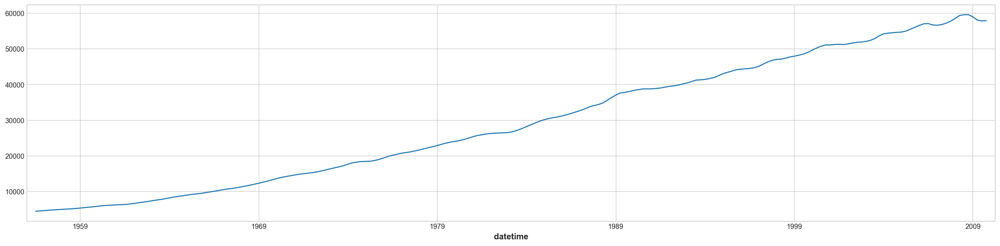

In [119]:
result=seasonal_decompose(df['electricity'], model='additive', period=4)
#fig=result.plot()
#fig.set_size_inches((16, 9))
plt.figure(figsize=(20,5))
result.trend.plot();

<Figure size 1440x360 with 0 Axes>

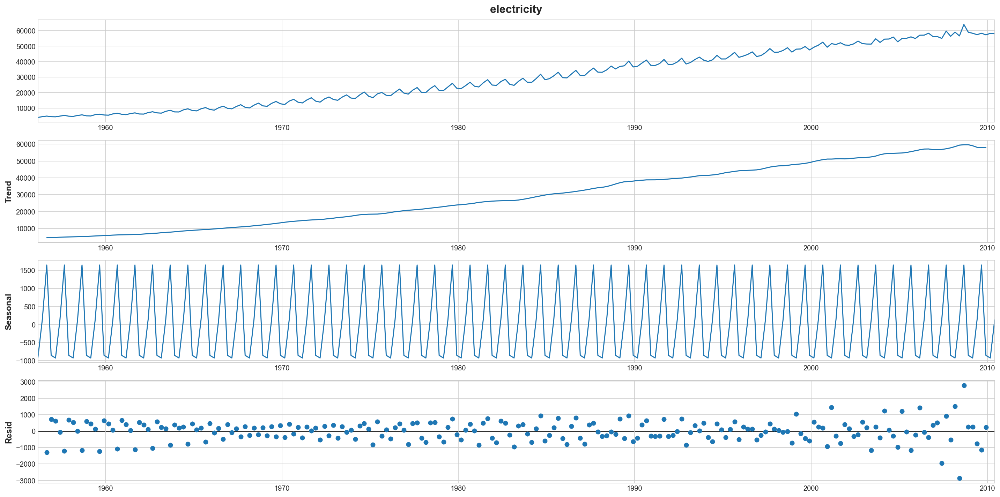

In [120]:
result=seasonal_decompose(df['electricity'], model='additive', period=4)
plt.figure(figsize=(20,5))
fig=result.plot();

#  Lag feature. Seasonality

In [121]:
el2022 = pd.read_csv('data/electricity-production and consumption_2022.csv',  delimiter=';',decimal=',')
el2022['timestamp'] = pd.to_datetime(el2022['Kuupaev (Eesti aeg)'], dayfirst=True)

consumption = el2022[['timestamp', 'Tarbimine']]
consumption.set_index('timestamp', inplace=True)
consumption = consumption.rename(columns = {'Tarbimine':'value'})
consumption.head()

,value
timestamp,
2022-01-01 00:00:00,899.4
2022-01-01 01:00:00,892.1
2022-01-01 02:00:00,874.3
2022-01-01 03:00:00,860.1
2022-01-01 04:00:00,842.7


## Seasonality. Patterns

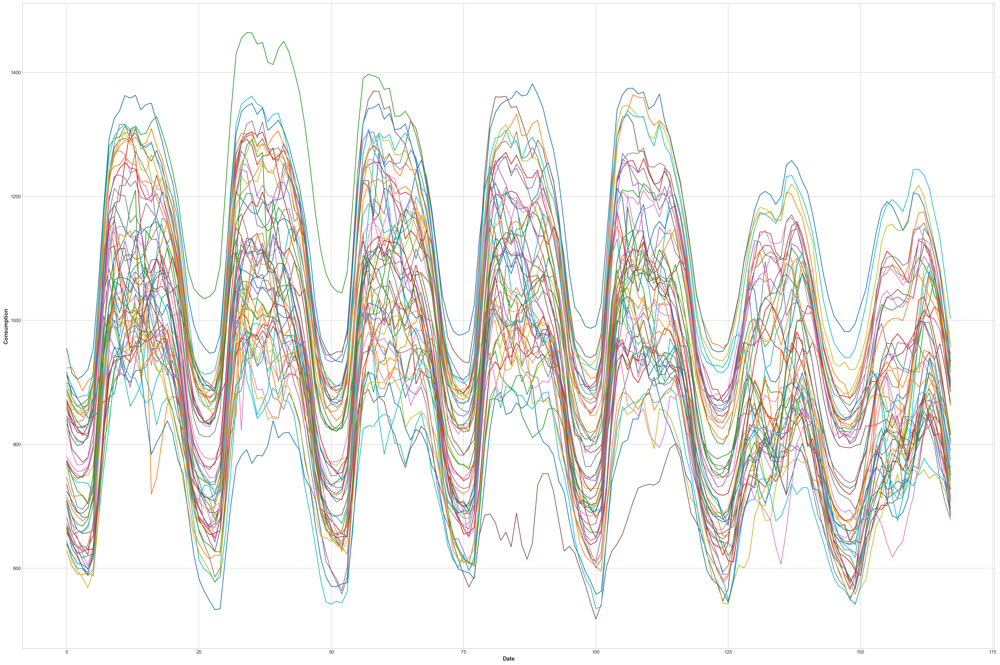

In [122]:
plt.figure(figsize=(30,20));
plt.xlabel('Date')
plt.ylabel('Consumption');
    
weeks = [g for n, g in consumption.groupby(pd.Grouper(freq = 'W'))]
for i in range(len(weeks)):
    weeks[i].reset_index(drop=True, inplace=True)
    plt.plot(weeks[i])

plt.show()
plt.close("all")      


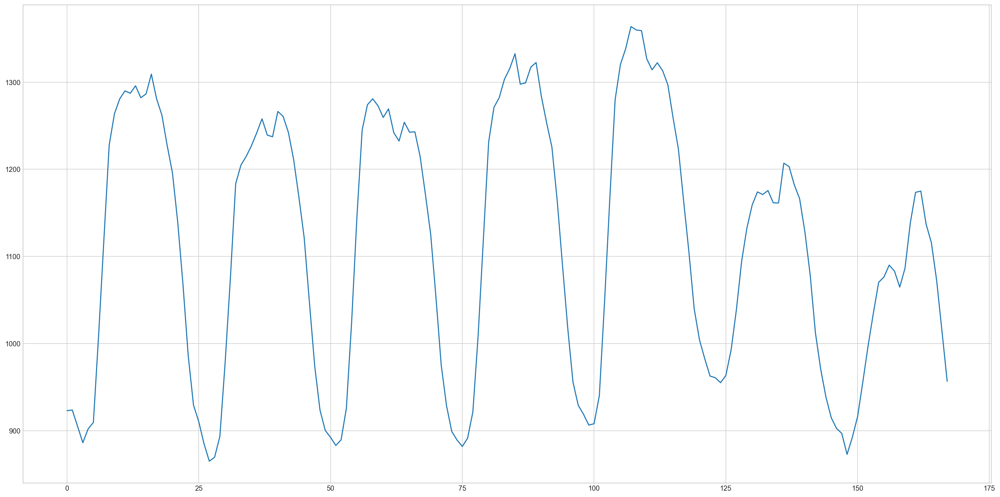

In [123]:
plt.plot(weeks[1])

plt.show()
plt.close("all")  

In [124]:
from sklearn.cluster import KMeans

In [125]:
def plot_clusters(data, title, c, f):
    periods = [g for n, g in data.groupby(pd.Grouper(freq = f))]

    for i in range(len(periods)):
        periods[i] = periods[i].rename(str(i))
        periods[i].reset_index(drop=True, inplace=True)

    df = pd.DataFrame(periods)
    df = df.dropna()

    
    kmeans = KMeans(n_clusters=c)
    cluster_found = kmeans.fit_predict(df)
    cluster_values, cluster_counts = np.unique(kmeans.labels_, return_counts=True)


    cluster_found_sr = pd.Series(cluster_found, name='cluster')
    df = df.set_index(cluster_found_sr, append=True )



    fig, ax= plt.subplots(1,1, figsize=(20,10))
    color_list = ['blue','red','green','black','orange','purple', 'cyan']
    color_list = color_list[0:(c)]
   

    
    for cluster, color in zip(cluster_values, color_list):
        df.xs(cluster, level=1).T.plot(
            ax=ax, legend=False, alpha=0.050, color=color, label= f'Cluster {cluster}'
        )
        
        median_centroid=df.xs(cluster, level=1).median()
        
        median_centroid.plot(
            ax=ax, color=color, alpha=0.9, ls='--'
        )
        

    ax.legend()
    plt.xlabel('Index', fontsize=18)
    plt.ylabel('Production', fontsize=18)
    plt.legend('', frameon=False)
    plt.yticks(fontsize=18)
    plt.xticks(fontsize=18)
    
    return plt;

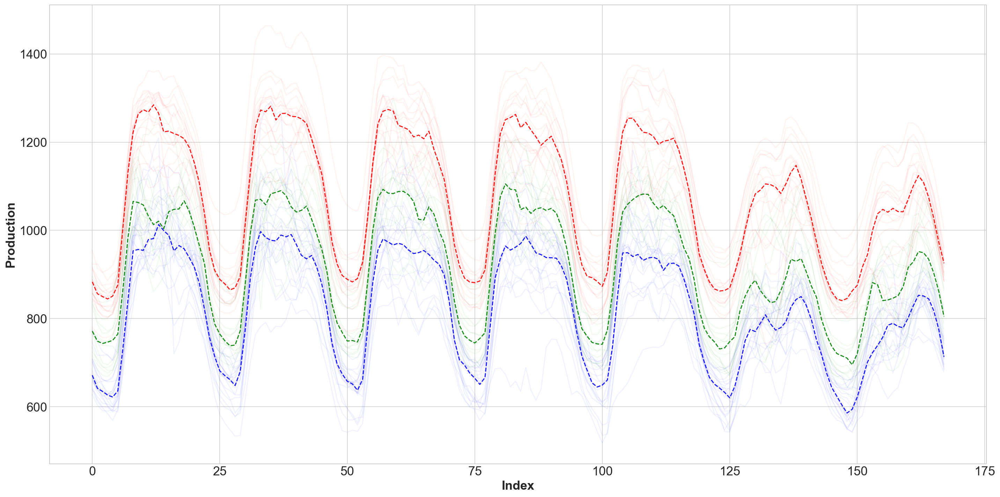

In [128]:
plot_clusters(consumption['value'], 'Consumption', 3, 'W');

<Figure size 1440x360 with 0 Axes>

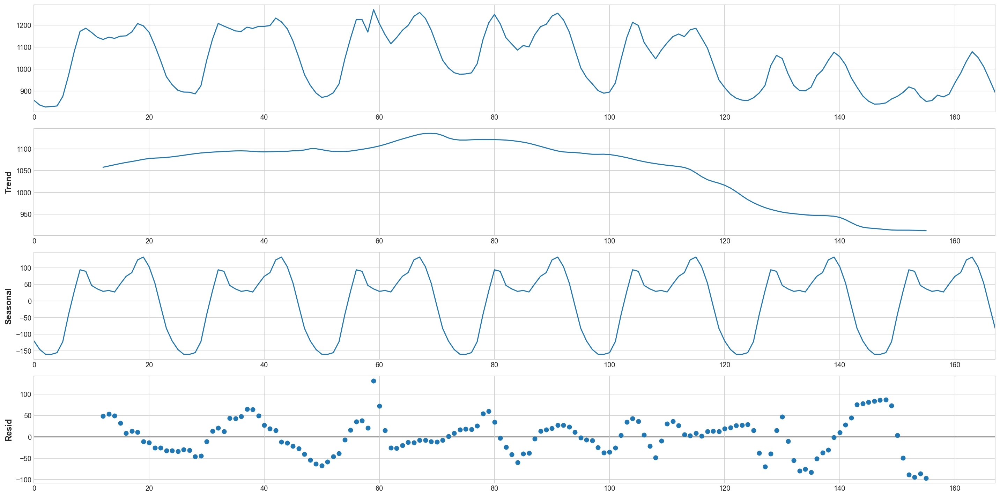

In [129]:
result=seasonal_decompose(weeks[10], model='additive', period=24)
plt.figure(figsize=(20,5))
result.plot();

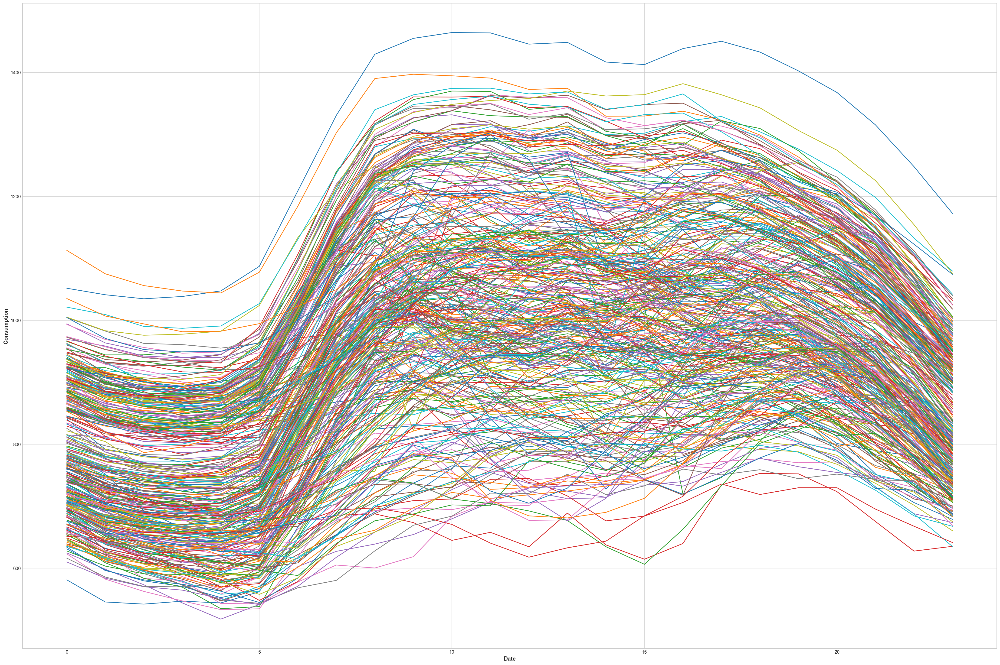

In [130]:
plt.figure(figsize=(30,20));
plt.xlabel('Date')
plt.ylabel('Consumption');
    
weeks = [g for n, g in consumption.groupby(pd.Grouper(freq = 'D'))]
for i in range(len(weeks)):
    weeks[i].reset_index(drop=True, inplace=True)
    plt.plot(weeks[i])

plt.show()
plt.close("all")      


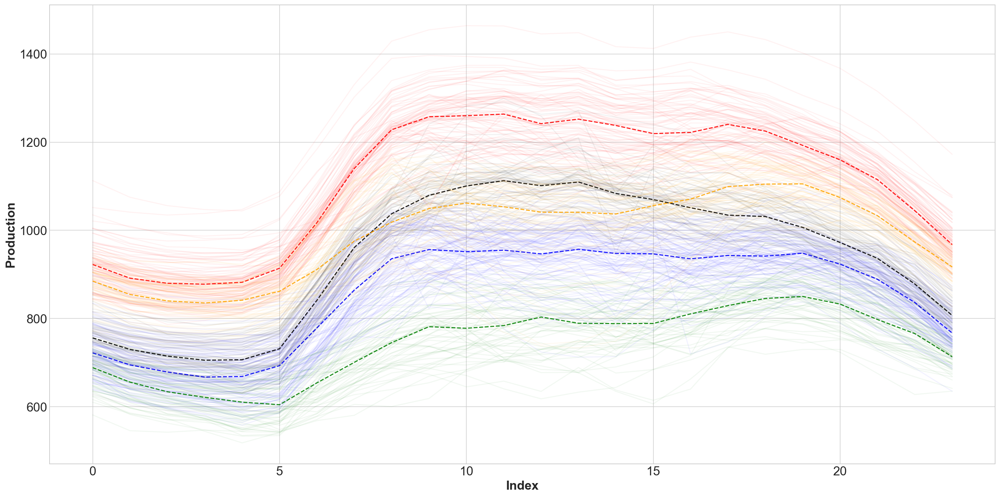

In [134]:
plot_clusters(consumption['value'], 'Consumption', 5, 'D');

## Seasonality from seasonal decomposition

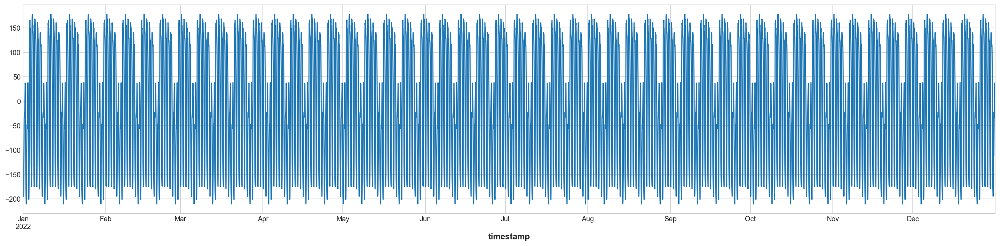

In [135]:
result=seasonal_decompose(consumption, model='additive', period=24*7)
plt.figure(figsize=(20,5))
result.seasonal.plot();

<Figure size 1440x360 with 0 Axes>

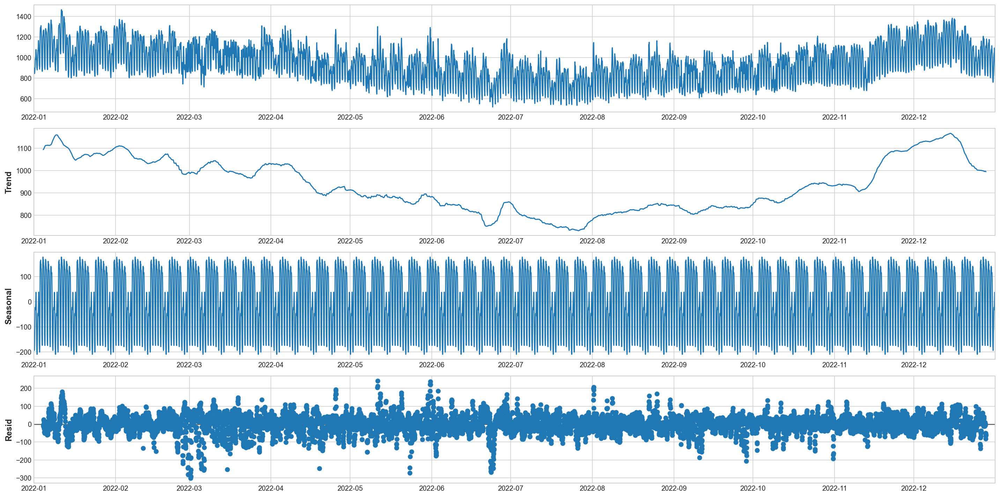

In [136]:
result=seasonal_decompose(consumption, model='additive', period=24*7)
plt.figure(figsize=(20,5))
result.plot();

# De-trend/seasonality

In [137]:
au_elec_series_short.head(10)

,electricity
datetime,
1956-03-01,3923
1956-06-01,4436
1956-09-01,4806
1956-12-01,4418
1957-03-01,4339
1957-06-01,4811
1957-09-01,5259
1957-12-01,4735
1958-03-01,4608


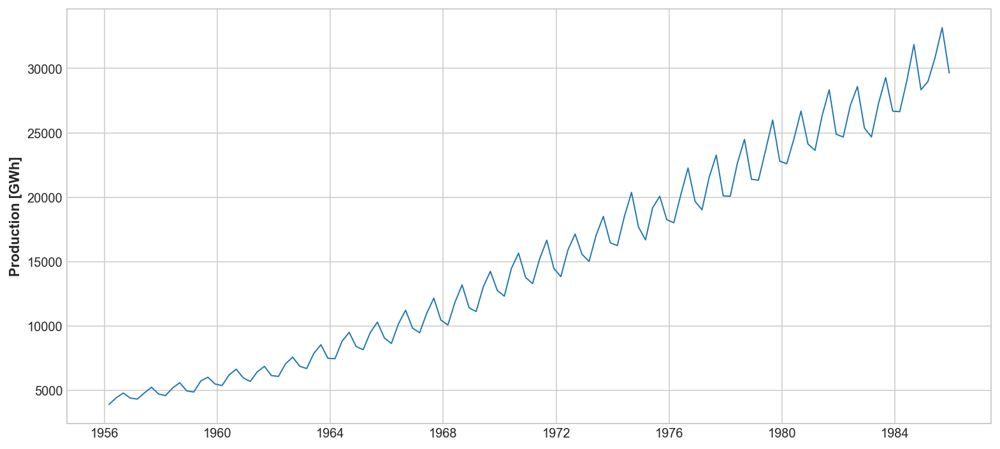

In [138]:
plt.figure(figsize=(11, 5))
plt.plot(au_elec_series_short['electricity'], lw=1)
plt.ylabel('Production [GWh]', fontsize=11)
plt.show()

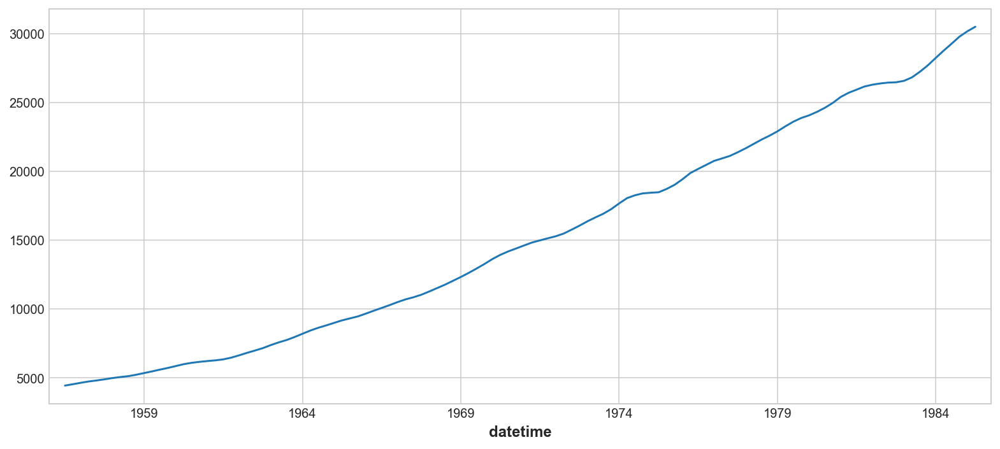

In [139]:
au_result = seasonal_decompose(au_elec_series_short['electricity'], model='additive', period=4)
plt.figure(figsize=(11,5))
au_result.trend.plot();

In [88]:
de_trend = au_elec_series_short['electricity']- au_result.trend

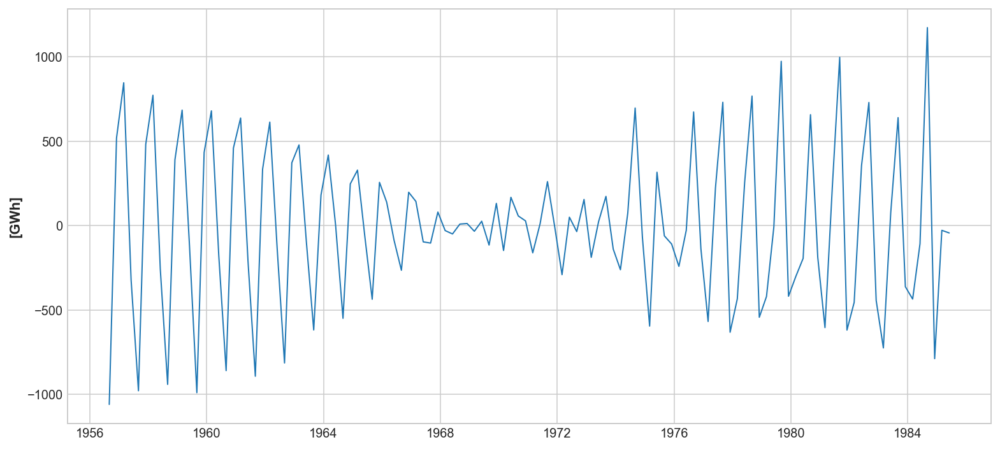

In [140]:
plt.figure(figsize=(11, 5))
plt.plot(de_trend, lw=1)
plt.ylabel('[GWh]', fontsize=11)
plt.show()

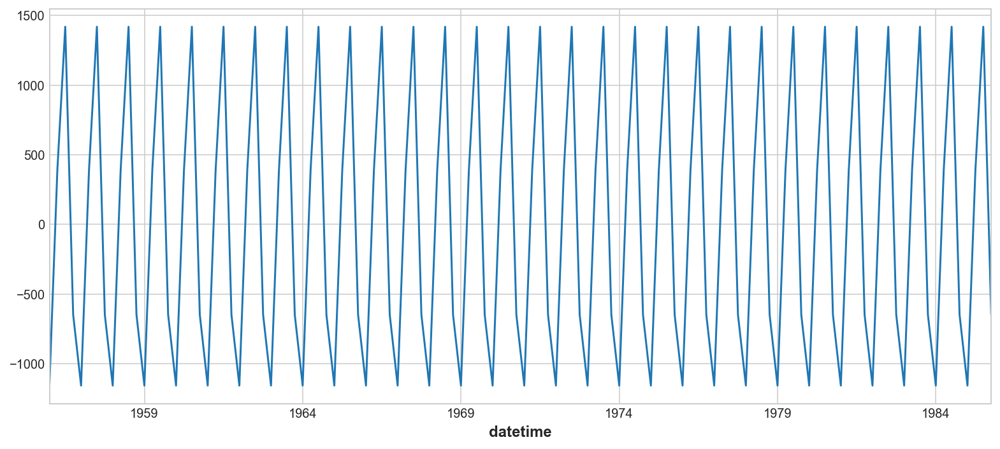

In [141]:
plt.figure(figsize=(11,5))
au_result.seasonal.plot();

In [142]:
de_trend = de_trend - au_result.seasonal

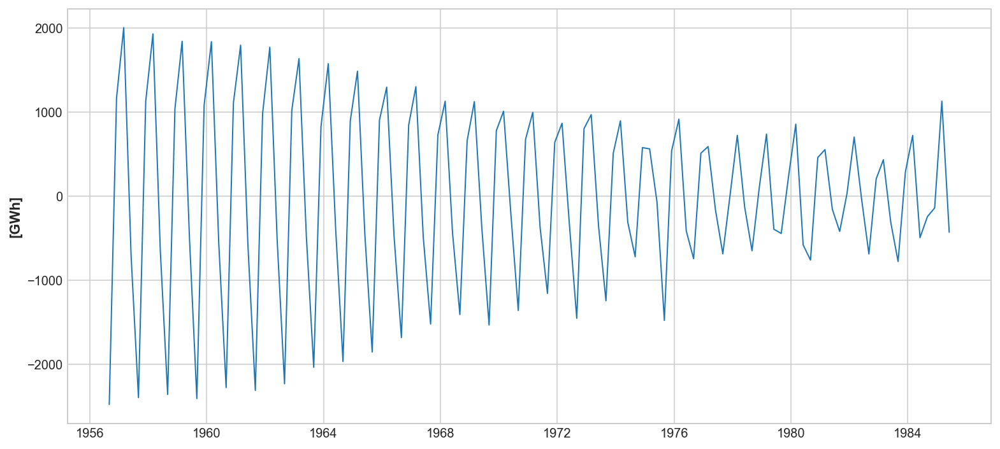

In [143]:
plt.figure(figsize=(11, 5))
plt.plot(de_trend, lw=1)
plt.ylabel('[GWh]', fontsize=11)
plt.show()